<a href="https://colab.research.google.com/github/lihaochen987/bird_detector/blob/main/ML_Workshop_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


## Boring Imports
---



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# Setting up FiftyOne dataset
!pip install fiftyone
!pip install tensorflow torch torchvision umap-learn
!pip install ipywidgets>=7.5
!pip uninstall --yes opencv-python-headless==4.5.5.62
!pip install opencv-python-headless==4.1.2.30
!pip install ipyplot

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.5 MB 7.8 MB/s 
     |████████████████████████████████| 47 kB 6.6 MB/s 
     |████████████████████████████████| 13.2 MB 53.2 MB/s 
     |████████████████████████████████| 226 kB 74.5 MB/s 
     |████████████████████████████████| 132 kB 62.6 MB/s 
     |████████████████████████████████| 133 kB 78.1 MB/s 
     |████████████████████████████████| 48.3 MB 1.2 MB/s 
     |████████████████████████████████| 61 kB 349 kB/s 
     |████████████████████████████████| 135 kB 65.6 MB/s 
     |████████████████████████████████| 508 kB 73.4 MB/s 
     |████████████████████████████████| 563 kB 75.1 MB/s 
     |████████████████████████████████| 55 kB 4.9 MB/s 
     |████████████████████████████████| 29.2 MB 1.3 MB/s 
     |████████████████████████████████| 79.9 MB 109 kB/s 
     |████████████████████████████████| 106 kB 57.3 MB/s 
     |███████████████████████████████

## Configuring the Dataset

In [3]:
import fiftyone as fo
import fiftyone.zoo as foz
import random

desired_class = "Bird"

dataset = foz.load_zoo_dataset(
    "open-images-v6",
    label_types=["detections"],
    classes=[desired_class.capitalize()],
    max_samples=250,
    shuffle=True,
    seed = 5,
    num_workers = 20,
)

NumExpr defaulting to 2 threads.
Migrating database to v0.16.4
 100% |██████|    4.8Gb/4.8Gb [4.8s elapsed, 0s remaining, 1.0Gb/s]         
 100% |███████████████████| 250/250 [3.8s elapsed, 0s remaining, 76.2 files/s]       
 100% |███████████████████| 250/250 [3.8s elapsed, 0s remaining, 78.1 files/s]       
 100% |███████████████████| 250/250 [3.8s elapsed, 0s remaining, 79.3 files/s]       
Dataset info written to '/root/fiftyone/open-images-v6/info.json'
Loading 'open-images-v6' split 'train'
 100% |█████████████████| 250/250 [1.3s elapsed, 0s remaining, 192.9 samples/s]         
Loading 'open-images-v6' split 'test'
 100% |█████████████████| 250/250 [803.2ms elapsed, 0s remaining, 311.3 samples/s]      
Loading 'open-images-v6' split 'validation'
 100% |█████████████████| 250/250 [820.9ms elapsed, 0s remaining, 306.7 samples/s]      
Dataset 'open-images-v6-250' created


In [5]:
from fiftyone import ViewField as F

data_view = dataset.filter_labels("detections", (F("label") == desired_class) & (F("IsGroupOf") == False))

# Visualize the dataset in the FiftyOne App
session = fo.launch_app(view=data_view)

## Installing YoloV5

In [6]:
# Clone YOLO-V5, change to its directory and install dependencies
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!pip install -r requirements.txt

Cloning into 'yolov5'...
remote: Enumerating objects: 12270, done.
remote: Counting objects: 100% (20/20), done.
remote: Compressing objects: 100% (19/19), done.
remote: Total 12270 (delta 5), reused 9 (delta 1), pack-reused 12250
Receiving objects: 100% (12270/12270), 12.02 MiB | 31.64 MiB/s, done.
Resolving deltas: 100% (8491/8491), done.
/content/yolov5
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 596 kB 7.4 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [7]:
# Constructing the yaml file
import yaml

yaml_file = dict(
    path = "../dataset/FiftyOne",
    train = "/content/dataset/train/images",
    val = "/content/dataset/validate/images",
    test = "/content/dataset/test/images",
    nc = 1,
    names = [desired_class],
                 )

with open(r'/content/yolov5/data/FiftyOne.yaml', 'w') as file:
    documents = yaml.dump(yaml_file, file)
    print(yaml_file)

{'path': '../dataset/FiftyOne', 'train': '/content/dataset/train/images', 'val': '/content/dataset/validate/images', 'test': '/content/dataset/test/images', 'nc': 1, 'names': ['Bird']}


##Create dataset directories

In [8]:
# Create dataset directories
!mkdir /content/dataset
!mkdir /content/dataset/train /content/dataset/train/images /content/dataset/train/labels
!mkdir /content/dataset/validate /content/dataset/validate/images /content/dataset/validate/labels
!mkdir /content/dataset/test /content/dataset/test/images /content/dataset/test/labels

In [9]:
# Export dataset into select directories
import os
import shutil

export_dir = "/content"
dataset_type = fo.types.YOLOv5Dataset
label_field = "detections"

data_view.export(
    export_dir=export_dir,
    dataset_type=dataset_type,
    label_field=label_field,
)

for filename in os.listdir("/content/images/val"):
  random_value = random.randrange(10)
  if random_value == 0:
    filename = filename[:filename.index(".")]
    shutil.move("/content/images/val/{}.jpg".format(filename), "/content/dataset/test/images/{}.jpg".format(filename))
    shutil.move("/content/labels/val/{}.txt".format(filename), "/content/dataset/test/labels/{}.txt".format(filename))
  elif random_value == 1:
    filename = filename[:filename.index(".")]
    shutil.move("/content/images/val/{}.jpg".format(filename), "/content/dataset/validate/images/{}.jpg".format(filename))
    shutil.move("/content/labels/val/{}.txt".format(filename), "/content/dataset/validate/labels/{}.txt".format(filename))
  else:
    filename = filename[:filename.index(".")]
    shutil.move("/content/images/val/{}.jpg".format(filename), "/content/dataset/train/images/{}.jpg".format(filename))
    shutil.move("/content/labels/val/{}.txt".format(filename), "/content/dataset/train/labels/{}.txt".format(filename))



Directory '/content' already exists; export will be merged with existing files
 100% |█████████████████| 713/713 [3.8s elapsed, 0s remaining, 188.7 samples/s]      


## Training the model

In [10]:
# Train the model
!python train.py --img 640 --batch 32 --epochs 10 --data /content/yolov5/data/FiftyOne.yaml --weights yolov5n.pt --single-cls

train: weights=yolov5n.pt, cfg=, data=/content/yolov5/data/FiftyOne.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=10, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=True, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-259-ga2a1ed2 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.

In [11]:
# View tensorboard
%load_ext tensorboard
%tensorboard --logdir runs/train

<IPython.core.display.Javascript object>

## Detecting with the model

In [12]:
# Detect test images
!python detect.py --source /content/dataset/test/images --weights /content/yolov5/runs/train/exp/weights/best.pt --img 640 --save-txt --save-conf

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/dataset/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-259-ga2a1ed2 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 1760518 parameters, 0 gradients
image 1/79 /content/dataset/test/images/002d1d05a2fac63c.jpg: 448x640 Done. (0.014s)
image 2/79 /content/dataset/test/images/06019a1f0f9e31a5.jpg: 480x640 1 Bird, Done. (0.014s)
image 3/79 /content/dataset/test/images/0a389d85258b5e0a.jpg: 448x640 1 Bird, Done. (0.010s)
image 4/79 /content/dataset/test/images/0c887ceec9504160.jpg: 480x640 2 Birds, 

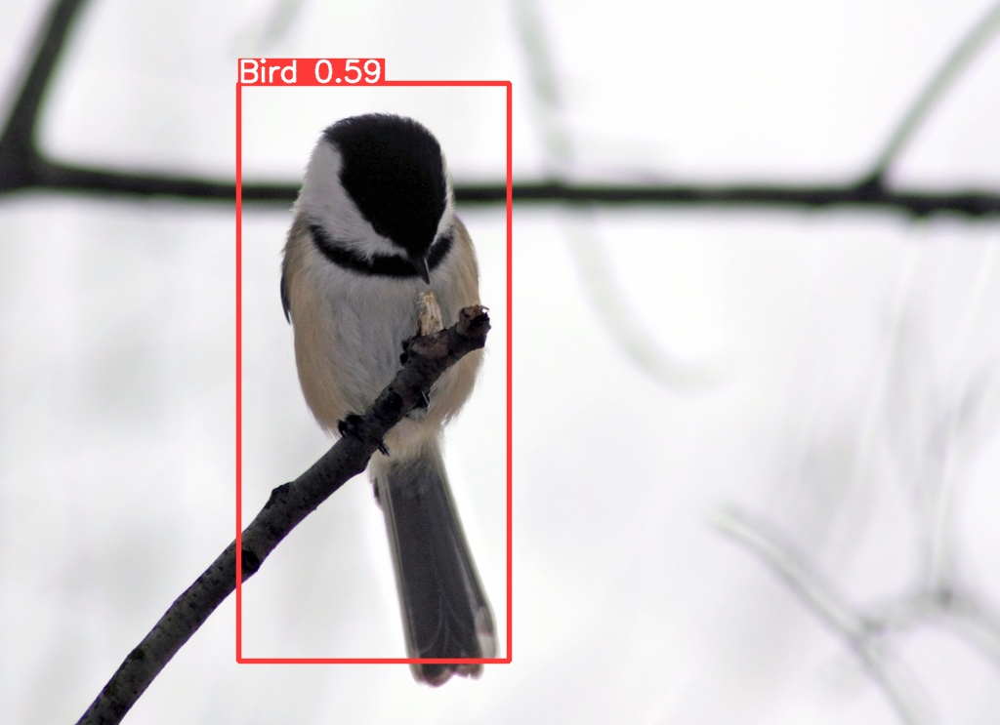

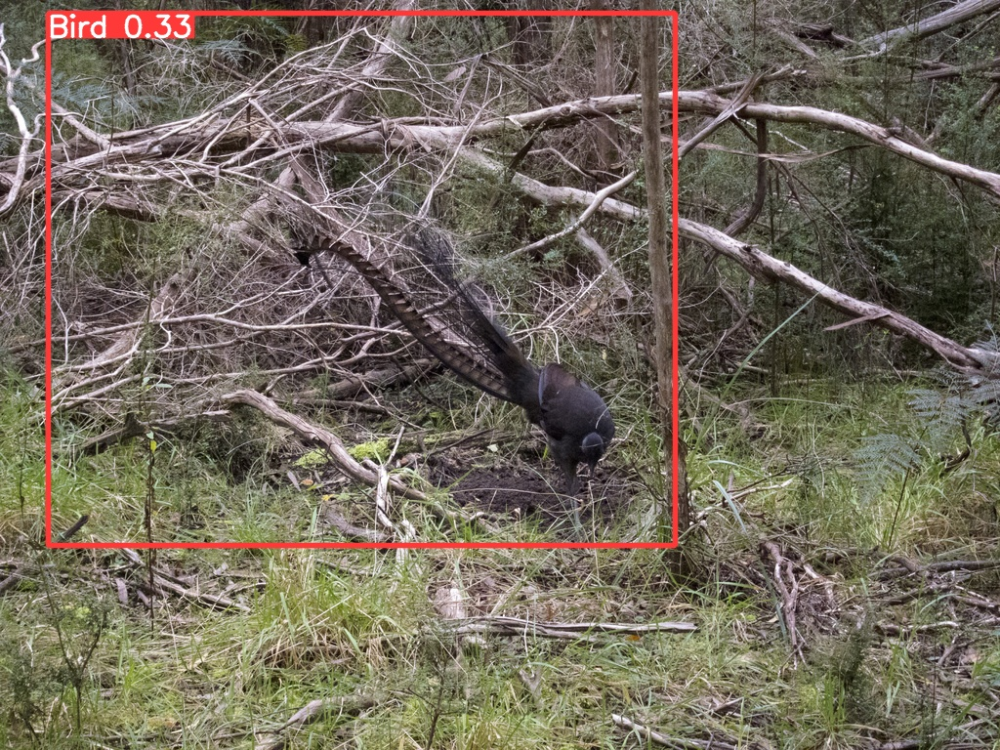

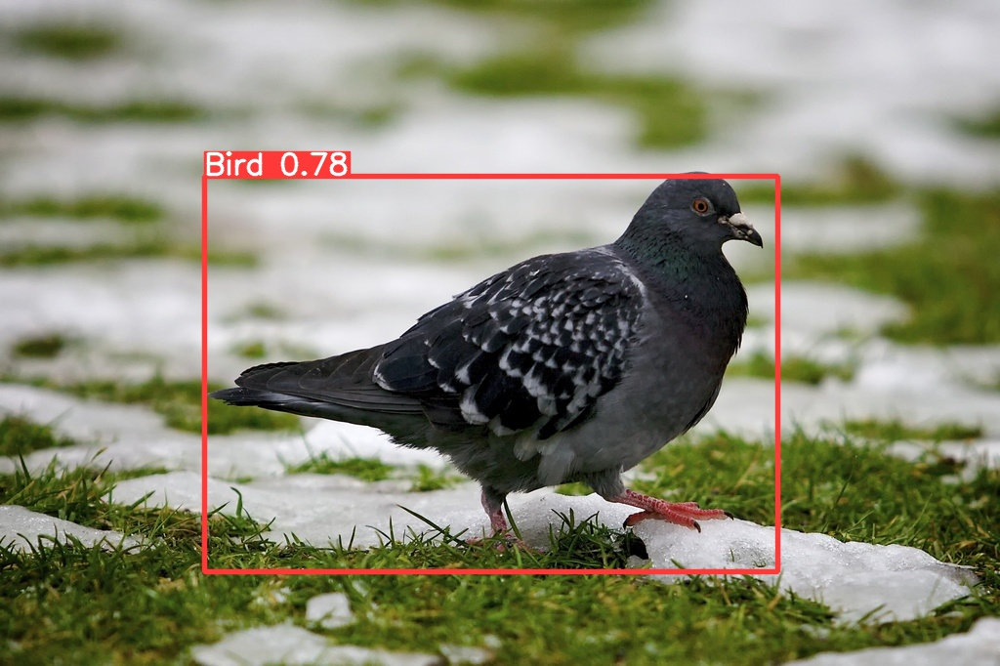

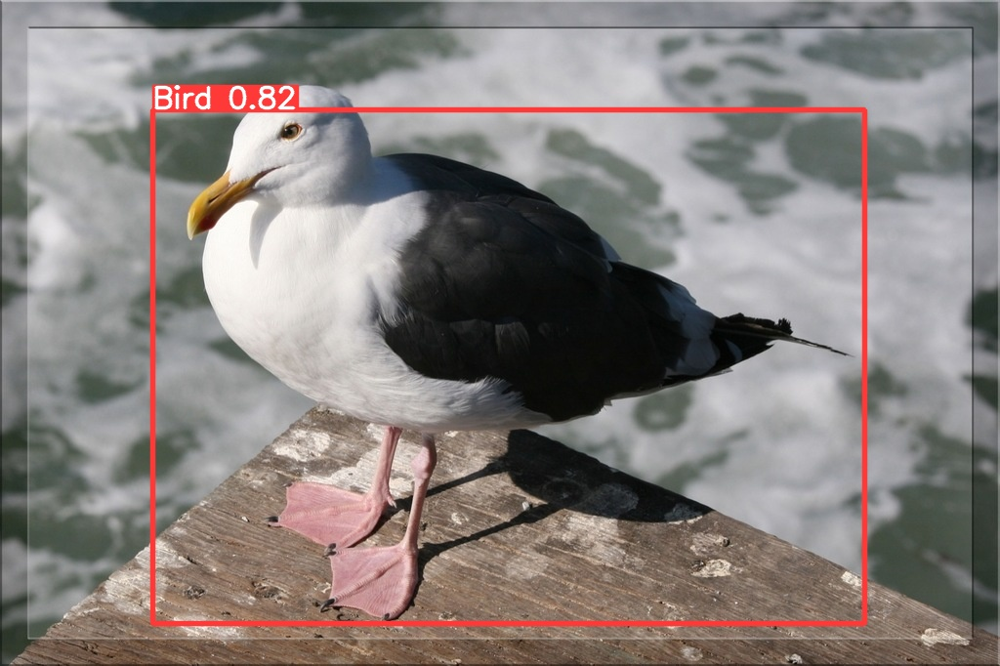

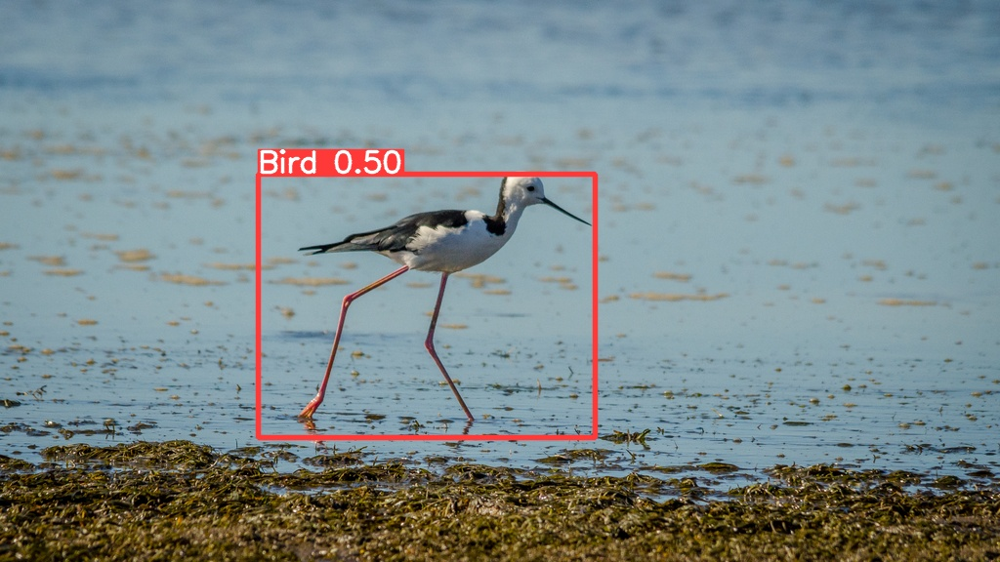

...

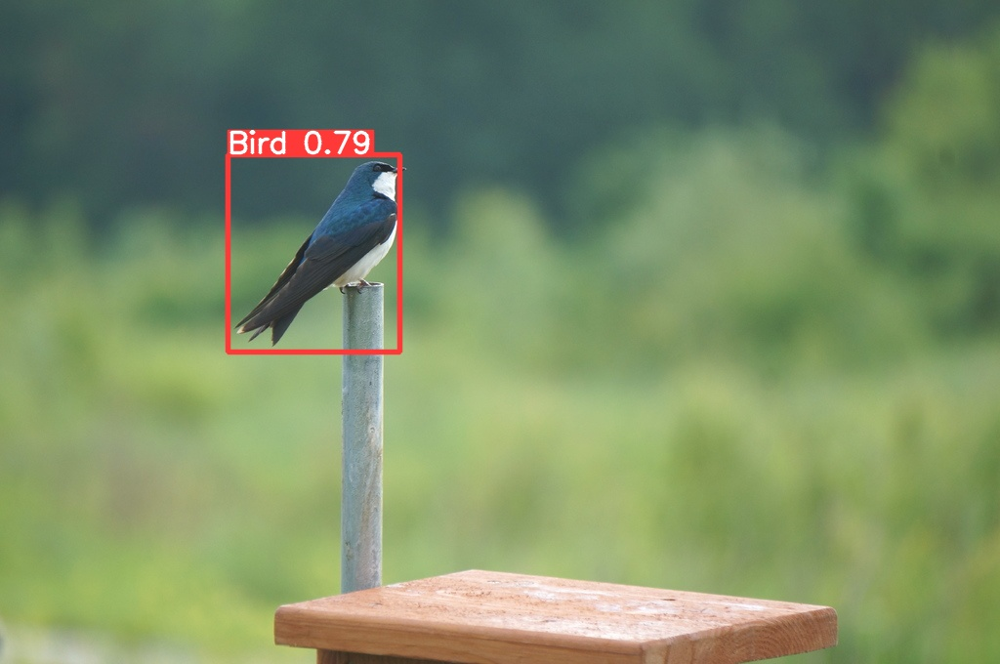

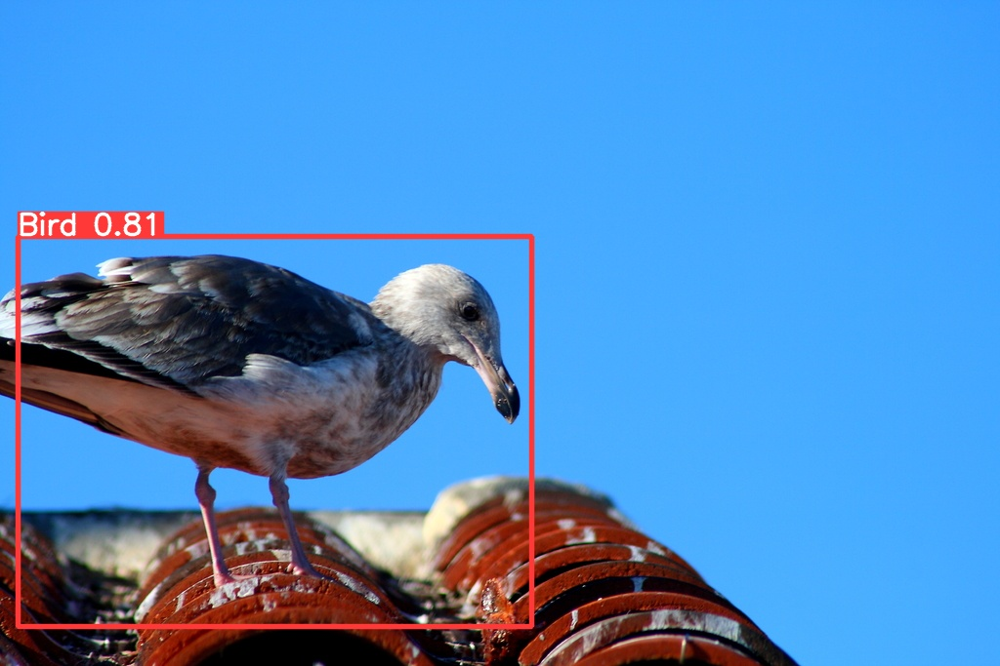

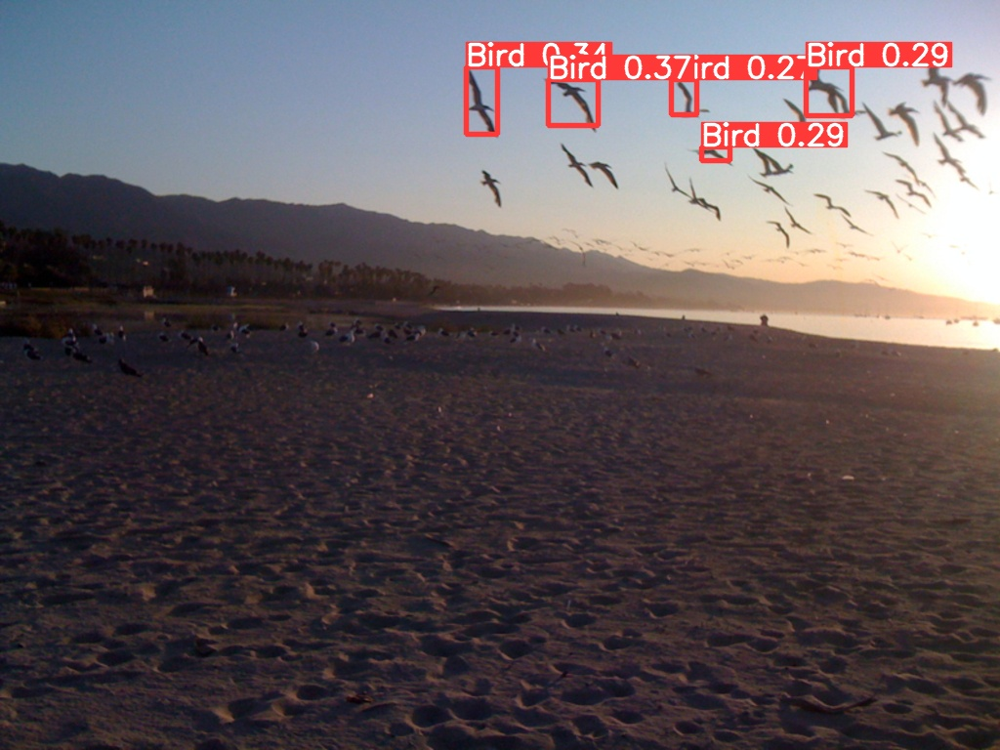

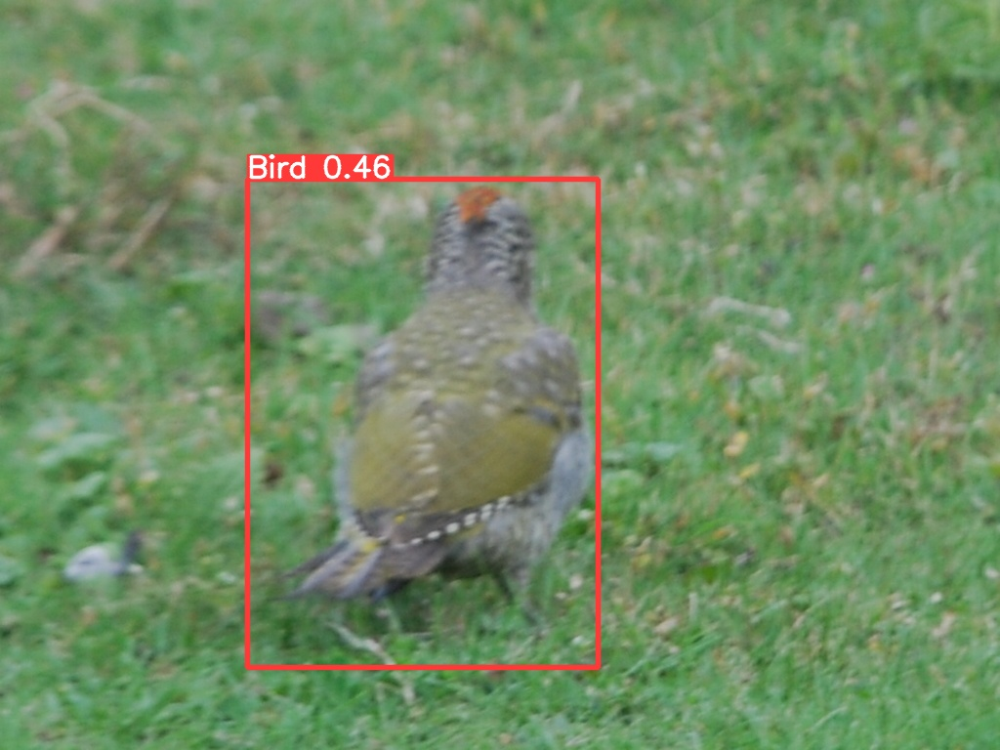

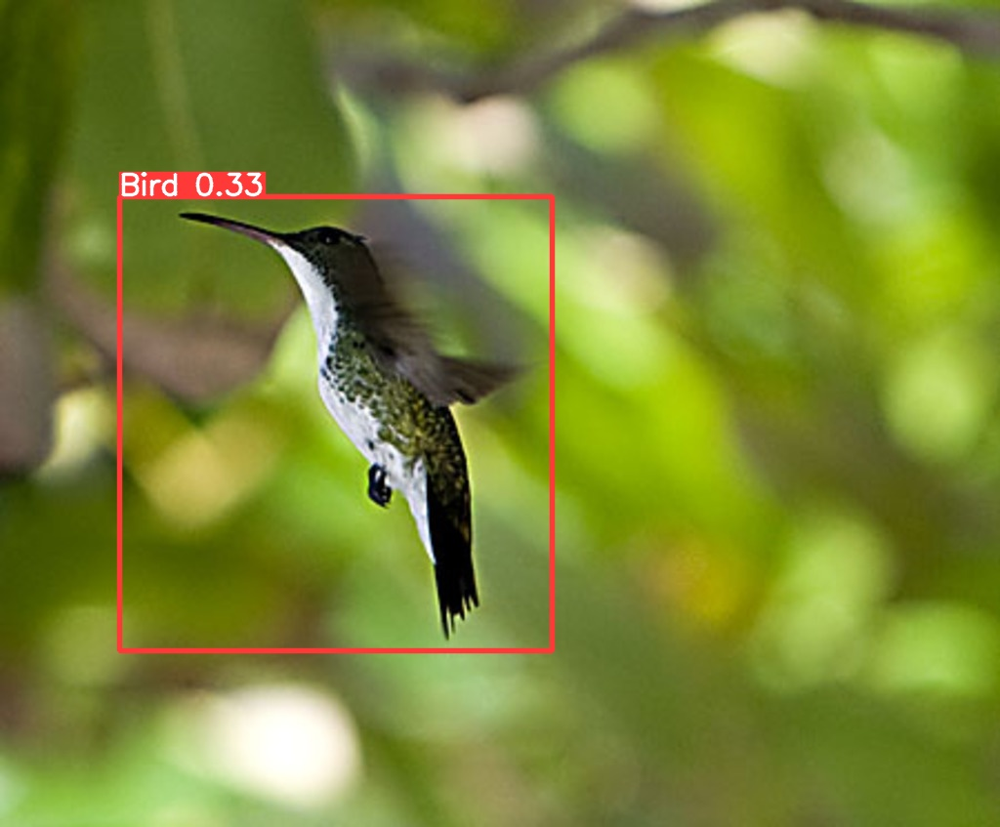

In [14]:
import ipyplot
from PIL import Image
from IPython.display import display, Image

images_list = []
folder = "/content/yolov5/runs/detect/exp"

for image in os.listdir(f'{folder}'):
  if (image == "labels"):
    continue
  else:
    display(Image(filename = folder + "/" + image))

## Additional detections for those in-person (CODE BELOW WILL UTILISE YOUR WEBCAM)

#Required installations
- Python (https://www.python.org/)
- Git (https://git-scm.com/download/win)

1. Clone YoloV5 into selected directory with "git clone https://github.com/ultralytics/yolov5.git"
2. Install requirements with "pip install -r requirements.txt"
3. Download the best.pt file in yolov5/runs/train/exp/weights/best.pt
4. Move best.pt into YoloV5 directory
5. Run the detection with "python3 detect.py --source 0 --weights best.pt"